In [5]:
import pandas as pd
import folium
from folium import plugins
import geocoder
import geopy
import numpy as np
from branca.element import Figure

In [6]:
for df in pd.read_csv('data/trajectories_nostokes_subset_10000.csv.gz', chunksize=10007, usecols=['lat', 'lon']):
    new_df = df
    break
new_df= new_df.dropna()
# new_df.to_csv('traj_nostoks_subset.csv')
print(new_df)

             lat       lon
0      43.310062  5.194578
1      43.298130  5.283924
2      43.288410  5.178498
3      43.300564  5.252904
4      43.348278  4.999713
...          ...       ...
10002  36.975475 -1.857935
10003  36.842907 -1.956594
10004  36.908478 -1.853759
10005  36.884270 -1.835889
10006  36.719383 -2.046364

[10007 rows x 2 columns]


In [149]:
## Circle Markers
map_circle = folium.Map(location=[42.588517, 5.194578], zoom_start=8)
# map_circle = folium.Map(location=[42.6461, 4.8340], zoom_start=9)

# latitude longitude tool
# map_circle.add_child(folium.LatLngPopup())

### Map options
# plugin for mini map
minimap = plugins.MiniMap(toggle_display=True)

# add minimap to map
map_circle.add_child(minimap)

# add scroll zoom toggler to map
plugins.ScrollZoomToggler().add_to(map_circle)

# add full screen button to map
plugins.Fullscreen(position='topright').add_to(map_circle)


## Trajectory data
for index,row in new_df.iterrows():
    folium.CircleMarker(location=[row.lat, row.lon], radius=3, color='#f5bd56', fill_color='green').add_to(map_circle)

map_circle.save('maps/nostokes_map1.html')

map_1 = Figure(height=450)
map_1.add_child(map_circle)

map_1

In [8]:
df = pd.read_csv('data/trajectories_nostokes_subset_10000.csv.gz', usecols=['obs', 'traj', 'MPA', 'lat', 'lon'])
trajs = {}

for i in range(0,10021):
    trajs[str(i)] = df.loc[df['traj'] == i] 

In [9]:
trajs["100"]

,obs,traj,MPA,lat,lon
100,0,100,1.0,43.282280,5.310420
10107,1,100,1.0,43.278330,5.310389
20114,2,100,1.0,43.274517,5.310200
30121,3,100,1.0,43.270832,5.309878
40128,4,100,1.0,43.267254,5.309510
...,...,...,...,...,...
9576799,957,100,0.0,40.958120,3.170492
9586806,958,100,0.0,40.954876,3.171572
9596813,959,100,0.0,40.951550,3.172664
9606820,960,100,0.0,40.948130,3.173770


In [151]:
## Antpath map
antpath_map = folium.Map(location=[42.288517, 5.171321], zoom_start=7)
# add scroll zoom toggler to map
plugins.ScrollZoomToggler().add_to(antpath_map)

for i in range(0,10):
    traj_route_lats = np.array(trajs[str(i)].lat)
    traj_route_lon = np.array(trajs[str(i)].lon)
    traj_routes = np.vstack((traj_route_lats,traj_route_lon)).T    
    
    folium.CircleMarker(location=[traj_route_lats[0], traj_route_lon[0]], radius=4, color='green').add_to(antpath_map)
    folium.CircleMarker(location=[traj_route_lats[-1], traj_route_lon[-1]], radius=3, color='red').add_to(antpath_map)
    
    plugins.AntPath(traj_routes).add_to(antpath_map)

    
map_2 = Figure(height=450)
map_2.add_child(antpath_map)
antpath_map.save('maps/nostokes_map2.html')
map_2  

In [17]:
# trajs1 = {}
# for i in range(0, 100):
#     trajs1[str(i)] = df.loc[df['traj'] == i] 

In [16]:
# trajs1

In [90]:
def load_and_subset_trajectories(
    file_name, num_traj=300, use_random=False
):

    df = pd.read_csv(file_name)

    # the whole dataset is too big to open here.
    if use_random:
        # Let's subset to fewer random trajectories:
        random_trajs = np.random.choice(
            np.unique(df["traj"]), num_traj, replace=False
        )
        traj_mask = df["traj"].apply(lambda x: x in random_trajs)
    else:
        # Let's use the first N trajectories
        first_n_trajs = np.unique(df["traj"])[:num_traj]
        traj_mask = df["traj"].apply(lambda x: x in first_n_trajs)
    
    df = df[traj_mask]
    
    return df

In [91]:
df1 = load_and_subset_trajectories("data/trajectories_nostokes_subset_10000.csv.gz")

In [92]:
df1 = df1.set_index(["traj", "obs"]).sort_index(level=0)
df1

MPA    distance      land        lat       lon       temp  \
traj obs                                                               
0    0     1.0    0.000000  0.000000  43.310062  5.194578  13.392999   
     1     1.0    0.188183  0.000000  43.308975  5.196365  13.394862   
     2     1.0    0.367667  0.000000  43.307938  5.198070  13.396412   
     3     1.0    0.539166  0.000000  43.306946  5.199698  13.397730   
     4     1.0    0.704321  0.000000  43.305990  5.201263  13.398852   
...        ...         ...       ...        ...       ...        ...   
299  957  10.0  127.124750  0.997826  43.397495  4.583243   0.043368   
     958  10.0  127.124750  0.997826  43.397495  4.583243   0.043352   
     959  10.0  127.124750  0.997826  43.397495  4.583243   0.043337   
     960  10.0  127.124750  0.997826  43.397495  4.583243   0.043321   
     961  10.0  127.124750  0.997826  43.397495  4.583243   0.043320   

                         time         z  
traj obs                                 
0    0             2017-03-01  1.018237  
     1    2017-03-01 01:00:00  1.018237  
     2    2017-03-01 02:00:00  1.018237  
     3    2017-03-01 03:00:00  1.018237  
     4    2017-03-01 04:00:00  1.018237  
...                       ...       ...  
299  957  2017-09-05 21:00:00  7.920377  
     958  2017-09-05 22:00:00  7.920377  
     959  2017-09-05 23:00:00  7.920377  
     960  2017-09-06 00:00:00  7.920377  
     961           2017-09-06  7.920377  

[288600 rows x 8 columns]

In [93]:
df1 = df1[["lat", "lon"]]
df1

lat       lon
traj obs                     
0    0    43.310062  5.194578
     1    43.308975  5.196365
     2    43.307938  5.198070
     3    43.306946  5.199698
     4    43.305990  5.201263
...             ...       ...
299  957  43.397495  4.583243
     958  43.397495  4.583243
     959  43.397495  4.583243
     960  43.397495  4.583243
     961  43.397495  4.583243

[288600 rows x 2 columns]

In [47]:
from functools import reduce
import sklearn.cluster

In [48]:
# kmeans = sklearn.cluster.KMeans(n_clusters=4)

In [49]:
# kmeans.fit(df1)

KMeans(n_clusters=4)

In [50]:
# df1["cluster_id"] = kmeans.fit_predict(df1)

C:\Users\Home\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [94]:
df1

lat       lon
traj obs                     
0    0    43.310062  5.194578
     1    43.308975  5.196365
     2    43.307938  5.198070
     3    43.306946  5.199698
     4    43.305990  5.201263
...             ...       ...
299  957  43.397495  4.583243
     958  43.397495  4.583243
     959  43.397495  4.583243
     960  43.397495  4.583243
     961  43.397495  4.583243

[288600 rows x 2 columns]

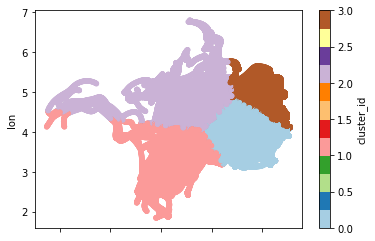

In [52]:
# df1.plot.scatter(x="lat", y="lon", c="cluster_id", cmap="Paired");

In [95]:
num_bins_lat = 10
num_bins_lon = 30

lat_bins = np.linspace(df1["lat"].min(), df1["lat"].max(), num_bins_lat)
lon_bins = np.linspace(df1["lon"].min(), df1["lon"].max(), num_bins_lon)

In [96]:
df1["lat_bin"] = np.digitize(df1["lat"], lat_bins, right=True)
df1["lon_bin"] = np.digitize(df1["lon"], lon_bins, right=True)

df1["bin_tup"] = list(zip(df1["lat_bin"], df1["lon_bin"]))

df1["lat_bin_pos"] = lat_bins[np.digitize(df1["lat"], lat_bins, right=True)] - 0.5 * np.diff(lat_bins)[0]
df1["lon_bin_pos"] = lon_bins[np.digitize(df1["lon"], lon_bins, right=True)] - 0.5 * np.diff(lon_bins)[0]

df1

C:\Users\Home\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\Home\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Home\anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

lat       lon  lat_bin  lon_bin  bin_tup  lat_bin_pos  \
traj obs                                                                
0    0    43.310062  5.194578        9       20  (9, 20)    43.282211   
     1    43.308975  5.196365        9       20  (9, 20)    43.282211   
     2    43.307938  5.198070        9       20  (9, 20)    43.282211   
     3    43.306946  5.199698        9       20  (9, 20)    43.282211   
     4    43.305990  5.201263        9       20  (9, 20)    43.282211   
...             ...       ...      ...      ...      ...          ...   
299  957  43.397495  4.583243        9       17  (9, 17)    43.282211   
     958  43.397495  4.583243        9       17  (9, 17)    43.282211   
     959  43.397495  4.583243        9       17  (9, 17)    43.282211   
     960  43.397495  4.583243        9       17  (9, 17)    43.282211   
     961  43.397495  4.583243        9       17  (9, 17)    43.282211   

          lon_bin_pos  
traj obs               
0    0       5.171939  
     1       5.171939  
     2       5.171939  
     3       5.171939  
     4       5.171939  
...               ...  
299  957     4.659810  
     958     4.659810  
     959     4.659810  
     960     4.659810  
     961     4.659810  

[288600 rows x 7 columns]

In [97]:
ref_traj = 6

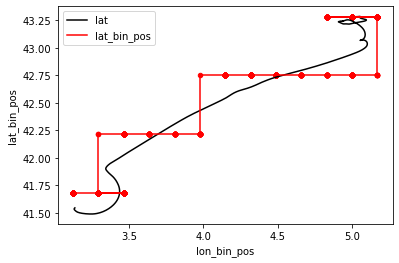

In [98]:
ax = df1.loc[ref_traj].plot.line(x="lon", y="lat", c="k")
df1.loc[ref_traj].plot.scatter(x="lon_bin_pos", y="lat_bin_pos", c="r", ax=ax);
df1.loc[ref_traj].plot.line(x="lon_bin_pos", y="lat_bin_pos", c="r", ax=ax);

In [99]:
from editdistance import distance as edist

In [100]:
df1.loc[df1.index.levels[0][ref_traj]]

,lat,lon,lat_bin,lon_bin,bin_tup,lat_bin_pos,lon_bin_pos
obs,,,,,,,
0,43.275917,4.968131,9,19,"(9, 19)",43.282211,5.001229
1,43.276356,4.969854,9,19,"(9, 19)",43.282211,5.001229
2,43.276768,4.971571,9,19,"(9, 19)",43.282211,5.001229
3,43.277140,4.973282,9,19,"(9, 19)",43.282211,5.001229
4,43.277504,4.974989,9,19,"(9, 19)",43.282211,5.001229
...,...,...,...,...,...,...,...
957,41.543236,3.133738,6,8,"(6, 8)",41.679787,3.123425
958,41.543922,3.134266,6,8,"(6, 8)",41.679787,3.123425
959,41.544610,3.134835,6,8,"(6, 8)",41.679787,3.123425


In [101]:
dist_to_ref = np.array([
    edist(
        df1.loc[traj]["bin_tup"],
        df1.loc[df1.index.levels[0][ref_traj]]["bin_tup"]
    )
    for traj in df1.index.levels[0]
])

In [102]:
from matplotlib import pyplot as plt

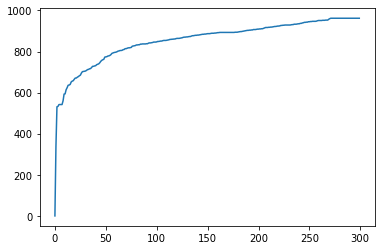

In [103]:
plt.plot(np.sort(dist_to_ref))

In [104]:
trajs_close_to_ref = df1.index.levels[0][dist_to_ref < 750]
trajs_close_to_ref

Int64Index([  4,   6,  15,  16,  24,  30,  32,  44,  53,  61,  71,  72,  87,
             90,  96, 101, 103, 114, 116, 121, 126, 129, 139, 146, 153, 161,
            162, 165, 170, 178, 179, 194, 211, 229, 233, 248, 250, 259, 264,
            273, 275, 281, 282, 285, 292],
           dtype='int64', name='traj')

<AxesSubplot:xlabel='lon'>

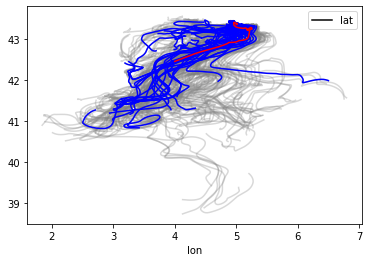

In [105]:
ax = df1.loc[trajs_close_to_ref[0]].plot.line(x="lon", y="lat", c="k")
for traj in df1.index.levels[0]:
    df1.loc[traj].plot.line(x="lon", y="lat", c="gray", alpha=0.3, ax=ax, legend=False)
for traj in trajs_close_to_ref:
    df1.loc[traj].plot.line(x="lon", y="lat", c="blue", ax=ax, legend=False)
df1.loc[trajs_close_to_ref[0]].plot.line(x="lon", y="lat", c="r", ax=ax, legend=False)

In [133]:
df1

lat       lon  lat_bin  lon_bin  bin_tup  lat_bin_pos  \
traj obs                                                                
0    0    43.310062  5.194578        9       20  (9, 20)    43.282211   
     1    43.308975  5.196365        9       20  (9, 20)    43.282211   
     2    43.307938  5.198070        9       20  (9, 20)    43.282211   
     3    43.306946  5.199698        9       20  (9, 20)    43.282211   
     4    43.305990  5.201263        9       20  (9, 20)    43.282211   
...             ...       ...      ...      ...      ...          ...   
299  957  43.397495  4.583243        9       17  (9, 17)    43.282211   
     958  43.397495  4.583243        9       17  (9, 17)    43.282211   
     959  43.397495  4.583243        9       17  (9, 17)    43.282211   
     960  43.397495  4.583243        9       17  (9, 17)    43.282211   
     961  43.397495  4.583243        9       17  (9, 17)    43.282211   

          lon_bin_pos  
traj obs               
0    0       5.171939  
     1       5.171939  
     2       5.171939  
     3       5.171939  
     4       5.171939  
...               ...  
299  957     4.659810  
     958     4.659810  
     959     4.659810  
     960     4.659810  
     961     4.659810  

[288600 rows x 7 columns]

In [153]:
## Antpath map
cluster_map = folium.Map(location=[42.288517, 5.171321], zoom_start=7)
# add scroll zoom toggler to map
plugins.ScrollZoomToggler().add_to(cluster_map)

for i in df1.index.levels[0]:
    traj_route_lats = np.array(df1.loc[i].lat)
    traj_route_lon = np.array(df1.loc[i].lon)
    traj_routes = np.vstack((traj_route_lats,traj_route_lon)).T    
    
    folium.PolyLine(traj_routes, color='gray', weight=1, opacity=0.6).add_to(cluster_map)
    
for i in trajs_close_to_ref:
    traj_route_lats = np.array(df1.loc[i].lat)
    traj_route_lon = np.array(df1.loc[i].lon)
    traj_routes = np.vstack((traj_route_lats,traj_route_lon)).T    
    
    folium.PolyLine(traj_routes, color='#03A9F4', weight=2, opacity=0.7).add_to(cluster_map)
    
traj_close_to_ref_lat = np.array(df1.loc[trajs_close_to_ref[0]].lat)
traj_close_to_ref_lon = np.array(df1.loc[trajs_close_to_ref[0]].lon)
traj_close_to_ref_routes = np.vstack((traj_close_to_ref_lat,traj_close_to_ref_lon)).T
folium.PolyLine(traj_close_to_ref_routes, color='red', weight=3, opacity=0.8).add_to(cluster_map)


ref_traj_lat = np.array(df1.loc[ref_traj].lat)
ref_traj_lon = np.array(df1.loc[ref_traj].lon)
ref_traj_routes = np.vstack((ref_traj_lat,ref_traj_lon)).T
plugins.AntPath(ref_traj_routes).add_to(cluster_map)

    
map_3 = Figure(height=450)
map_3.add_child(cluster_map)
cluster_map.save('maps/nostokes_map3.html')
map_3  